<a href="https://colab.research.google.com/github/iamrajee/Slam_and_RL_BTP/blob/master/code/swarm/swarm_BTP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
from google.colab import files

# ===================== Simple implementation of pso (without class) ========= #

In [40]:
import random
import numpy as np 

#function that models the problem
def fitness_function(position):
    return position[0]**2 + position[1]**2 + 1

#Some variables to calculate the velocity
W = 0.5
c1 = 0.5
c2 = 0.9
target = 1

n_iterations = 50   #int(input("Inform the number of iterations: "))
target_error = 1e-6 #float(input("Inform the target error: "))
n_particles =  30   #int(input("Inform the number of particles: "))

particle_position_vector = np.array([np.array([(-1) ** (bool(random.getrandbits(1))) * random.random()*50, (-1)**(bool(random.getrandbits(1))) * random.random()*50]) for _ in range(n_particles)])
pbest_position = particle_position_vector
pbest_fitness_value = np.array([float('inf') for _ in range(n_particles)])
gbest_fitness_value = float('inf')
gbest_position = np.array([float('inf'), float('inf')])

velocity_vector = ([np.array([0, 0]) for _ in range(n_particles)])
iteration = 0
while iteration < n_iterations:
    for i in range(n_particles):
        fitness_cadidate = fitness_function(particle_position_vector[i])
        print(fitness_cadidate, ' ', particle_position_vector[i])
        
        if(pbest_fitness_value[i] > fitness_cadidate):
            pbest_fitness_value[i] = fitness_cadidate
            pbest_position[i] = particle_position_vector[i]

        if(gbest_fitness_value > fitness_cadidate):
            gbest_fitness_value = fitness_cadidate
            gbest_position = particle_position_vector[i]

    if(abs(gbest_fitness_value - target) < target_error):
        break
    
    for i in range(n_particles):
        new_velocity = (W*velocity_vector[i]) + (c1*random.random()) * (pbest_position[i] - particle_position_vector[i]) + (c2*random.random()) * (gbest_position-particle_position_vector[i])
        new_position = new_velocity + particle_position_vector[i]
        particle_position_vector[i] = new_position

    iteration = iteration + 1
    
print("The best position is ", gbest_position, "in iteration number ", iteration)

1146.890660363498   [21.82281616 25.87769996]
1576.394774396056   [ 17.82985304 -35.46112117]
1791.5518601209833   [ 39.41870826 -15.38561988]
403.07820533769717   [-18.69269575   7.25681273]
302.446472926263   [-16.75677384   4.54499761]
1267.2704807697628   [-13.13849086 -33.07038764]
2807.439400733908   [-31.79349951 -42.37467156]
200.61725369884942   [ -0.39042036 -14.12320168]
300.5487092089296   [ -1.52386707 -17.24025923]
1058.9974278376874   [20.39419515 25.33918373]
762.5447163479782   [-24.65762226  12.39138332]
2154.304598871142   [-45.38384486   9.67528939]
3951.5467605112235   [-44.52690381 -44.36103693]
838.0724624990733   [  9.0097042  -27.49359367]
2109.1587433244536   [-8.4943454  45.12211032]
3030.9320404608443   [45.94880835 30.30905891]
57.68771824348331   [ 0.21439934 -7.52607143]
603.0332002056742   [ 16.00603973 -18.59677102]
165.08445058129877   [12.80741785 -0.23344943]
401.5614861838767   [-15.03467951 -13.21059796]
1514.9852315016733   [17.99283485 34.4999003

# =========================== Above Implementation with classes ===========

In [0]:
# Imports
import random
import numpy as np 

In [0]:
# parameters
W = 0.5
c1 = 0.8
c2 = 0.9 

n_iterations = 50   #int(input("Inform the number of iterations: "))
target_error = 1e-6 #float(input("Inform the target error: "))
n_particles =  30   #int(input("Inform the number of particles: "))

In [0]:
# class of each particle
class Particle(): 
    def __init__(self):
        self.position = np.array([(-1) ** (bool(random.getrandbits(1))) * random.random()*50, (-1)**(bool(random.getrandbits(1))) * random.random()*50])
        self.pbest_position = self.position
        self.pbest_value = float('inf')
        self.velocity = np.array([0,0])

    def __str__(self):
        print("I am at ", self.position, " meu pbest is ", self.pbest_position)
    
    def move(self):
        self.position = self.position + self.velocity

In [0]:
# space or environment class
class Space():
    def __init__(self, target, target_error, n_particles):
        self.target = target
        self.target_error = target_error
        self.n_particles = n_particles
        self.particles = []
        self.gbest_value = float('inf')
        self.gbest_position = np.array([random.random()*50, random.random()*50])

    def print_particles(self):
        for particle in self.particles:
            particle.__str__()
   
    def fitness(self, particle):
        return particle.position[0] ** 2 + particle.position[1] ** 2 + 1

    def set_pbest(self):
        for particle in self.particles:
            fitness_cadidate = self.fitness(particle)
            if(particle.pbest_value > fitness_cadidate):
                particle.pbest_value = fitness_cadidate
                particle.pbest_position = particle.position
            

    def set_gbest(self):
        for particle in self.particles:
            best_fitness_cadidate = self.fitness(particle)
            if(self.gbest_value > best_fitness_cadidate):
                self.gbest_value = best_fitness_cadidate
                self.gbest_position = particle.position

    def move_particles(self):
        for particle in self.particles:
            global W
            new_velocity = (W*particle.velocity) + (c1*random.random()) * (particle.pbest_position - particle.position) + \
                            (random.random()*c2) * (self.gbest_position - particle.position)
            particle.velocity = new_velocity
            particle.move()

In [45]:
#=============== main call =====================#
search_space = Space(1, target_error, n_particles)
particles_vector = [Particle() for _ in range(search_space.n_particles)]
search_space.particles = particles_vector
search_space.print_particles()

iteration = 0
while(iteration < n_iterations):
    search_space.set_pbest()    
    search_space.set_gbest()

    if(abs(search_space.gbest_value - search_space.target) <= search_space.target_error):
        break

    search_space.move_particles()
    iteration += 1
    
print("The best solution is: ", search_space.gbest_position, " in n_iterations: ", iteration)

I am at  [-17.17619252 -30.13254427]  meu pbest is  [-17.17619252 -30.13254427]
I am at  [ 3.53833472 26.46830779]  meu pbest is  [ 3.53833472 26.46830779]
I am at  [ 20.25966668 -28.6387367 ]  meu pbest is  [ 20.25966668 -28.6387367 ]
I am at  [-20.21616514  17.03037277]  meu pbest is  [-20.21616514  17.03037277]
I am at  [-28.73629875 -17.98080721]  meu pbest is  [-28.73629875 -17.98080721]
I am at  [-32.9509585  -20.16740233]  meu pbest is  [-32.9509585  -20.16740233]
I am at  [43.25127595 26.73266769]  meu pbest is  [43.25127595 26.73266769]
I am at  [ 12.6214185  -36.53278524]  meu pbest is  [ 12.6214185  -36.53278524]
I am at  [39.20586934  8.90659378]  meu pbest is  [39.20586934  8.90659378]
I am at  [44.15271856 -0.15476284]  meu pbest is  [44.15271856 -0.15476284]
I am at  [-4.6274039  -9.40780914]  meu pbest is  [-4.6274039  -9.40780914]
I am at  [-23.94400508  37.58011192]  meu pbest is  [-23.94400508  37.58011192]
I am at  [49.94487562 10.23272144]  meu pbest is  [49.944875


# ======================== Implementation using psopy =======================#




In [46]:
# Imports
!pip install psopy
import psopy

In [47]:
import numpy as np
from psopy import *
from scipy.optimize import rosen
x0 = np.random.uniform(0, 2, (1000, 5))
print(x0.shape,"\n",x0,"\n")
# rosen sum(100.0*(x[1:] - x[:-1]**2.0)**2.0 + (1 - x[:-1])**2.0
res = minimize(rosen, x0, options={'stable_iter': 50})
res.x

(1000, 5) 
 [[0.09205938 0.56647666 1.34768935 0.01244127 0.7868705 ]
 [0.62088765 1.79368182 0.69805775 1.24397192 1.08333908]
 [0.47087029 0.92489051 1.90956906 0.81620381 1.23740433]
 ...
 [1.58258255 1.1533795  0.33630308 1.32029586 0.97045756]
 [0.40450538 0.57417122 1.88440281 1.58441735 0.70020937]
 [1.75717384 0.75172008 1.99242335 1.99872164 1.20838168]] 



array([1.00000006, 1.00000009, 1.00000017, 1.00000033, 1.00000058])

In [48]:
# The objective function.
fun = lambda x: (x[0] - 1)**2 + (x[1] - 2.5)**2
# The constraints.
cons = ({'type': 'ineq', 'fun': lambda x:  x[0] - 2 * x[1] + 2},
        {'type': 'ineq', 'fun': lambda x: -x[0] - 2 * x[1] + 6},
        {'type': 'ineq', 'fun': lambda x: -x[0] + 2 * x[1] + 2},
        {'type': 'ineq', 'fun': lambda x: x[0]},
        {'type': 'ineq', 'fun': lambda x: x[1]})
from psopy import init_feasible
x0 = init_feasible(cons, low=0., high=2., shape=(1000, 2))
print(x0.shape,"\n",x0,"\n")
#this doesn't work
res = minimize(fun, x0, constraints=cons, options={'g_rate': 1., 'l_rate': 1., 'max_velocity': 4., 'stable_iter': 50})
print("\n with constraints=>",res.x,"\n")
res = minimize(fun, x0, options={'g_rate': 1., 'l_rate': 1., 'max_velocity': 4., 'stable_iter': 50})
print("\n without=>",res.x,"\n")

(1000, 2) 
 [[0.92981579 0.47537161]
 [1.43159491 1.39863917]
 [0.18221036 0.6146464 ]
 ...
 [1.2969275  0.32594184]
 [1.59539205 0.2702703 ]
 [1.83496427 0.14739027]] 


 with constraints=> [1.39994444 1.69997272] 


 without=> [0.99999846 2.499999  ] 



#====================== Implementation using psoswarms ===================#

In [49]:
!pip install pyswarms

In [50]:
# =========== Basic Optimization ===========
import numpy as np# Import modules
import pyswarms as ps# Import PySwarms
from pyswarms.utils.functions import single_obj as fx
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [51]:
%%time
# =========== Optimizing a function ===========
options = {'c1': 0.5, 'c2': 0.3, 'w':0.9}# Set-up hyperparameters
optimizer = ps.single.GlobalBestPSO(n_particles=10, dimensions=2, options=options)# Call instance of PSO# Perform optimization

CPU times: user 6.9 ms, sys: 2.16 ms, total: 9.06 ms
Wall time: 8.45 ms


In [52]:
%%time
options = {'c1': 0.5, 'c2': 0.3, 'w':0.9, 'k': 2, 'p': 2}# Set-up hyperparameters
optimizer = ps.single.LocalBestPSO(n_particles=10, dimensions=2, options=options)# Call instance of PSO
cost, pos = optimizer.optimize(fx.sphere, iters=1000)# Perform optimization

2019-11-10 17:22:37,544 - pyswarms.single.local_best - INFO - Optimize for 1000 iters with {'c1': 0.5, 'c2': 0.3, 'w': 0.9, 'k': 2, 'p': 2}
pyswarms.single.local_best: 100%|██████████|1000/1000, best_cost=8.08e-44
2019-11-10 17:22:40,431 - pyswarms.single.local_best - INFO - Optimization finished | best cost: 8.079590352736497e-44, best pos: [-2.83895410e-22  1.41173494e-23]


CPU times: user 2.07 s, sys: 247 ms, total: 2.32 s
Wall time: 2.89 s


In [0]:
# =================== Optimizing a function with bounds ===========
# Create bounds
max_bound = 5.12 * np.ones(2)
min_bound = - max_bound
bounds = (min_bound, max_bound)

In [54]:
%%time
options = {'c1': 0.5, 'c2': 0.3, 'w':0.9}# Initialize swarm
optimizer = ps.single.GlobalBestPSO(n_particles=10, dimensions=2, options=options, bounds=bounds)# Call instance of PSO with bounds argument
cost, pos = optimizer.optimize(fx.rastrigin, iters=1000)# Perform optimization

2019-11-10 17:22:40,513 - pyswarms.single.global_best - INFO - Optimize for 1000 iters with {'c1': 0.5, 'c2': 0.3, 'w': 0.9}
pyswarms.single.global_best: 100%|██████████|1000/1000, best_cost=0
2019-11-10 17:22:42,901 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 0.0, best pos: [ 3.04862136e-09 -2.26744961e-10]


CPU times: user 1.84 s, sys: 265 ms, total: 2.1 s
Wall time: 2.4 s


In [0]:
# =======Basic Optimization with Arguments ===========

In [0]:
import numpy as np# import modules
# create a parameterized version of the classic Rosenbrock unconstrained optimzation function
def rosenbrock_with_args(x, a, b, c=0):
    f = (a - x[:, 0]) ** 2 + b * (x[:, 1] - x[:, 0] ** 2) ** 2 + c
    return f

In [57]:
from pyswarms.single.global_best import GlobalBestPSO
x_max = 10 * np.ones(2)# instatiate the optimizer
x_min = -1 * x_max
bounds = (x_min, x_max)
options = {'c1': 0.5, 'c2': 0.3, 'w': 0.9}
optimizer = GlobalBestPSO(n_particles=10, dimensions=2, options=options, bounds=bounds)
cost, pos = optimizer.optimize(rosenbrock_with_args, 1000, a=1, b=100, c=0)# now run the optimization, pass a=1 and b=100 as a tuple assigned to args

2019-11-10 17:22:43,025 - pyswarms.single.global_best - INFO - Optimize for 1000 iters with {'c1': 0.5, 'c2': 0.3, 'w': 0.9}
pyswarms.single.global_best: 100%|██████████|1000/1000, best_cost=3.61e-23
2019-11-10 17:22:45,860 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 3.612246446882192e-23, best pos: [1. 1.]


In [58]:
kwargs={"a": 1.0, "b": 100.0, 'c':0}
cost, pos = optimizer.optimize(rosenbrock_with_args, 1000, **kwargs)

2019-11-10 17:22:45,894 - pyswarms.single.global_best - INFO - Optimize for 1000 iters with {'c1': 0.5, 'c2': 0.3, 'w': 0.9}
pyswarms.single.global_best: 100%|██████████|1000/1000, best_cost=0
2019-11-10 17:22:48,288 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 0.0, best pos: [1. 1.]


In [59]:
cost, pos = optimizer.optimize(rosenbrock_with_args, 1000, a=1, b=100)

2019-11-10 17:22:48,323 - pyswarms.single.global_best - INFO - Optimize for 1000 iters with {'c1': 0.5, 'c2': 0.3, 'w': 0.9}
pyswarms.single.global_best: 100%|██████████|1000/1000, best_cost=0
2019-11-10 17:22:50,431 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 0.0, best pos: [1. 1.]


# =============================== cost Visualization=====================

In [0]:
# Import modules
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import Image

# Import PySwarms
import pyswarms as ps
from pyswarms.utils.functions import single_obj as fx
from pyswarms.utils.plotters import (plot_cost_history, plot_contour, plot_surface)

In [61]:
options = {'c1':0.5, 'c2':0.3, 'w':0.9}
optimizer = ps.single.GlobalBestPSO(n_particles=50, dimensions=2, options=options)
cost, pos = optimizer.optimize(fx.sphere, iters=100)

2019-11-10 17:22:50,512 - pyswarms.single.global_best - INFO - Optimize for 100 iters with {'c1': 0.5, 'c2': 0.3, 'w': 0.9}
pyswarms.single.global_best: 100%|██████████|100/100, best_cost=1.56e-8
2019-11-10 17:22:50,719 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 1.564502799117968e-08, best pos: [ 9.25631696e-05 -8.41254279e-05]


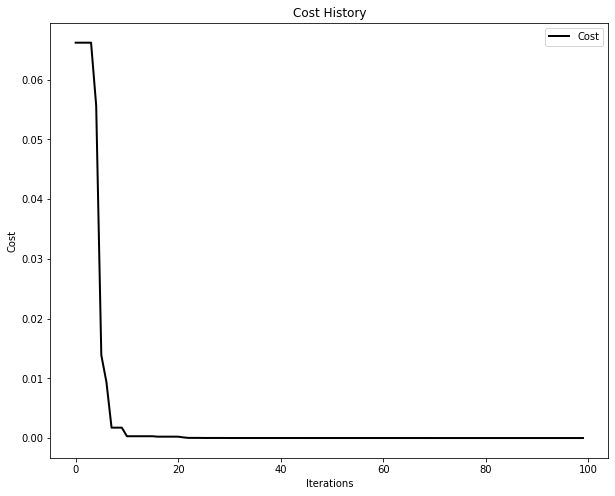

In [62]:
plot_cost_history(cost_history=optimizer.cost_history)
plt.show()

#==================Plotting ====================

In [0]:
#======================== Animating swarms==================
from pyswarms.utils.plotters.formatters import Mesher
m = Mesher(func=fx.sphere)# Initialize mesher with sphere function

#========= in 2-D space ===========

In [0]:
%%capture
animation = plot_contour(pos_history=optimizer.pos_history, mesher=m,mark=(0,0))# Make animation

2019-11-10 17:22:55,512 - matplotlib.animation - WARNING - MovieWriter imagemagick unavailable; trying to use <class 'matplotlib.animation.PillowWriter'> instead.
2019-11-10 17:22:55,514 - matplotlib.animation - INFO - Animation.save using <class 'matplotlib.animation.PillowWriter'>


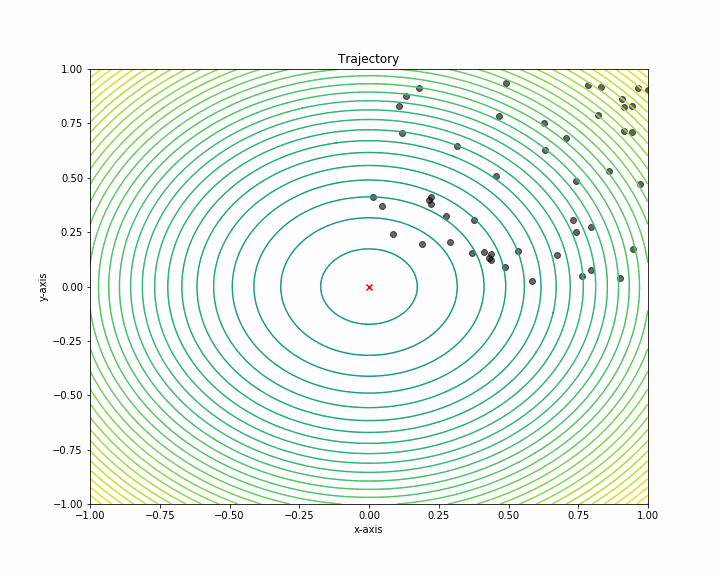

In [65]:
animation.save('plot0.gif', writer='imagemagick', fps=10)# Enables us to view it in a Jupyter notebook

# !cp plot0.gif plot0.gif.png
# Image(filename="plot0.gif.png")
# To ============= download gif ==============
# from google.colab import files
# files.download( "plot0.gif" )



with open('plot0.gif','rb') as f:
    display(Image(data=f.read(), format='png'))

In [0]:
# files.download( "plot0.gif" )

# ======== in 3-D space =============

In [0]:
# Obtain a position-fitness matrix using the Mesher.compute_history_3d()
# method. It requires a cost history obtainable from the optimizer class
pos_history_3d = m.compute_history_3d(optimizer.pos_history)

# Make a designer and set the x,y,z limits to (-1,1), (-1,1) and (-0.1,1) respectively
from pyswarms.utils.plotters.formatters import Designer
d = Designer(limits=[(-1,1), (-1,1), (-0.1,1)], label=['x-axis', 'y-axis', 'z-axis'])

In [0]:
%%capture
# Make animation
animation3d = plot_surface(pos_history=pos_history_3d, # Use the cost_history we computed
                           mesher=m, designer=d,       # Customizations
                           mark=(0,0,0))               # Mark minima

2019-11-10 17:23:13,967 - matplotlib.animation - WARNING - MovieWriter imagemagick unavailable; trying to use <class 'matplotlib.animation.PillowWriter'> instead.
2019-11-10 17:23:13,973 - matplotlib.animation - INFO - Animation.save using <class 'matplotlib.animation.PillowWriter'>


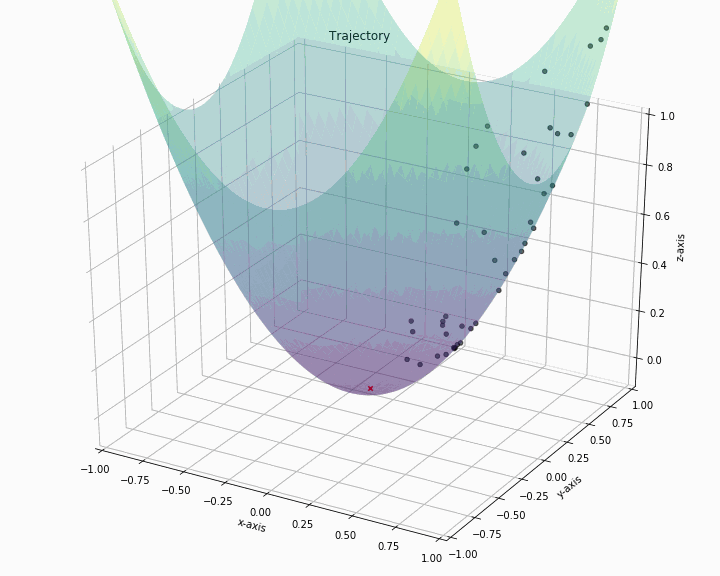

In [69]:
animation3d.save('plot1.gif', writer='imagemagick', fps=10)
with open('plot1.gif','rb') as f:
    display(Image(data=f.read(), format='png'))
# Image(url='plot1.gif')

In [0]:
# files.download( "plot1.gif" )

# ==================== Application of swarm : Inverse kinemetics ===============#


.

In [71]:
# Import modules
import numpy as np
# Import PySwarms
import pyswarms as ps
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [0]:
def distance(query, target):
    x_dist = (target[0] - query[0])**2
    y_dist = (target[1] - query[1])**2
    z_dist = (target[2] - query[2])**2
    dist = np.sqrt(x_dist + y_dist + z_dist)
    return dist

In [0]:
swarm_size = 20
dim = 6        # Dimension of X
epsilon = 1.0
options = {'c1': 1.5, 'c2':1.5, 'w':0.5}

constraints = (np.array([-np.pi , -np.pi/2 , 1 , -np.pi , -5*np.pi/36 , -np.pi]),
               np.array([np.pi  ,  np.pi/2 , 3 ,  np.pi ,  5*np.pi/36 ,  np.pi]))

d1 = d2 = d3 = d4 = d5 = d6 = 3

In [0]:

def getTransformMatrix(theta, d, a, alpha):
    T = np.array([[np.cos(theta) , -np.sin(theta)*np.cos(alpha) ,  np.sin(theta)*np.sin(alpha) , a*np.cos(theta)],
                  [np.sin(theta) ,  np.cos(theta)*np.cos(alpha) , -np.cos(theta)*np.sin(alpha) , a*np.sin(theta)],
                  [0             ,  np.sin(alpha)               ,  np.cos(alpha)               , d              ],
                  [0             ,  0                           ,  0                           , 1              ]
                 ])
    return T

In [0]:
def get_end_tip_position(params):
    # Create the transformation matrices for the respective joints
    t_00 = np.array([[1,0,0,0],[0,1,0,0],[0,0,1,0],[0,0,0,1]])
    t_01 = getTransformMatrix(params[0] , d2        , 0 , -np.pi/2)
    t_12 = getTransformMatrix(params[1] , d2        , 0 , -np.pi/2)
    t_23 = getTransformMatrix(0         , params[2] , 0 , -np.pi/2)
    t_34 = getTransformMatrix(params[3] , d4        , 0 , -np.pi/2)
    t_45 = getTransformMatrix(params[4] , 0         , 0 ,  np.pi/2)
    t_56 = getTransformMatrix(params[5] , d6        ,0  ,  0)

    # Get the overall transformation matrix
    end_tip_m = t_00.dot(t_01).dot(t_12).dot(t_23).dot(t_34).dot(t_45).dot(t_56)

    # The coordinates of the end tip are the 3 upper entries in the 4th column
    pos = np.array([end_tip_m[0,3],end_tip_m[1,3],end_tip_m[2,3]])
    return pos

In [0]:
def opt_func(X):
    n_particles = X.shape[0]  # number of particles
    target = np.array([-2,2,3])
    dist = [distance(get_end_tip_position(X[i]), target) for i in range(n_particles)]
    return np.array(dist)

In [77]:
%%time
# Call an instance of PSO
optimizer = ps.single.GlobalBestPSO(n_particles=swarm_size,
                                    dimensions=dim,
                                    options=options,
                                    bounds=constraints)

# Perform optimization
cost, joint_vars = optimizer.optimize(opt_func, iters=1000)

2019-11-10 17:24:05,571 - pyswarms.single.global_best - INFO - Optimize for 1000 iters with {'c1': 1.5, 'c2': 1.5, 'w': 0.5}
pyswarms.single.global_best: 100%|██████████|1000/1000, best_cost=0.0711
2019-11-10 17:24:14,559 - pyswarms.single.global_best - INFO - Optimization finished | best cost: 0.0710955897190613, best pos: [-2.24669825  1.03826622  1.08064706  1.77001439  0.28125515  1.78583051]


CPU times: user 7.55 s, sys: 361 ms, total: 7.91 s
Wall time: 9 s


In [78]:
print(get_end_tip_position(joint_vars))

[-2.05360574  2.04605945  3.00771588]


# =========================== END =====================================#